In [1]:
from mpl_toolkits import mplot3d
#%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import math
import time

In [2]:
#this part is function implementations
#1)	High Conditional Elliptic Function
def f_HCEF(X_set,D):
    Z=0
    for i in range(D):
        Z+=(10**6)**((i)/(D-1))*X_set[i]**2
    return Z

#2)	Bent Cigar Function
def f_BC(X_set,D):
    Z=X_set[0]**2
    for i in range(1,D):
        Z+= 10**6*X_set[i]**2
    return Z

#3)	Discus Function
def f_Discus(X_set,D):
    Z=(10**6)*(X_set[0]**2)
    for i in range(1,D):
        Z+=X_set[i]**2
    return Z

#4)	Rosenbrock’s Function
def f_Rosenbrock(X_set,D):
    Z=0
    for i in range(D-1):
        Z+=(100*(X_set[i]**2-X_set[i+1])**2+(X_set[i]-1)**2)
    return Z

#5)	Ackley’s Function
def f_Ackley(X_set,D):
    V1=0
    for i in range(D):
        V1+=X_set[i]**2
    V2=0
    for i in range(D):
        V2+=np.cos(2*math.pi*X_set[i])
    return -1*20*np.exp(-1*0.2*np.sqrt((1/D)*V1)) - np.exp((1/D)*V2)+20+math.e

#6)	Weierstrass Function
def f_Weierstrass(X_set,D):
    Kmax=20
    a=0.5
    b=3
    
    V1=0
    for i in range(D):
        for k in range(Kmax+1):
            V1+=a**k*np.cos(2*math.pi*b**k*(X_set[i]+0.5))
    V2=0
    for k in range(Kmax+1):
        V2+=a**k*np.cos(2*math.pi*b**k*0.5)
    return V1-D*V2

#7)	Griewank’s Function
def f_Griewank(X_set,D):
    V1=0
    for i in range(D):
        V1+=(X_set[i]**2)/(4000)
    V2=1
    for i in range(D):
        V2*=np.cos(X_set[i]/np.sqrt(i+1))
    return V1-V2+1

#8)	Rastrigin’s Function
def f_Rastrigin(X_set,D):
    Z=0
    for i in range(D):
        Z+=X_set[i]**2 - 10*np.cos(2*math.pi*X_set[i]) + 10
    return Z

In [3]:
#this part is to plot the 2 dimensional plots of the functions
def plot_func(func):
    #generate 100 number within the range [-10,10]
    x = np.linspace(-10, 10, 100)
    y = np.linspace(-10, 10, 100)

    #create two planes
    X, Y = np.meshgrid(x, y)

    #generate Z values for each x,y pairs within the planes for each functions
    Z = func([X,Y],2)

    #plot
    fig = plt.figure()
    ax = plt.axes(projection='3d')
    ax.contour3D(X, Y, Z, 100, cmap='viridis')
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z');
    plt.show()
#plot_func(f_Rastrigin)

In [4]:
import random
from numpy.random import choice
from copy import deepcopy
# import numpy as np
# import matplotlib.pyplot as plt
 

#THE PARTICLE SwARM OPTIMIZER===============
#==========================================================================================
#==========================================================================================
    
# the initialization function to generate initial random populations and the initial velocities
def initialization(NP, D, v_max, v_min):
    population=[]
    V=[]
    for i in range(NP):
        population.append([])
        V.append([])
        for j in range(D):
            #population[i].append(random.randint(-10,10))
            population[i].append(random.uniform(-10,10))
            V[i].append(random.uniform(v_min,v_max))
    #V = np.random.randn(NP, D)*0.1
    #print("initial population :",population)
    return population, V
 
#calculate fitness value for bounded trial vectors(input:2D list)
def calcFitness(population,func,D):
    score = []
    
    for i in range(len(population)):
        #print("fitness:",func(population[i]))
        if func == "HCEF":
            score.append(f_HCEF(population[i],D))
        elif func == "BC":
            score.append(f_BC(population[i],D))
        elif func == "Discus":
            score.append(f_Discus(population[i],D))
        elif func == "Rosenbrock":
            score.append(f_Rosenbrock(population[i],D))
        elif func == "Ackley":
            score.append(f_Ackley(population[i],D))
        elif func == "Weierstrass":
            score.append(f_Weierstrass(population[i],D))
        elif func =="Griewank":
            score.append(f_Griewank(population[i],D))
        elif func =="Rastrigin":
            score.append(f_Rastrigin(population[i],D))
    return score
# Update velocities
def velocity(population,V,gbest,pbest,C1,C2,W):
    p1=np.random.rand()
    p2=np.random.rand()
    
    for i in range(len(population)):
        for j in range(len(population[i])):
            V[i][j]=W*V[i][j] + C1*p1*(pbest[i][j]-population[i][j]) + C2*p2*(gbest[j]-population[i][j])
    return V
#update position
def positionUpdate(population,V):
    for i in range(len(population)):
        for j in range(len(population[i])):
            population[i][j]=population[i][j]+V[i][j]
            if(population[i][j]>10):
                population[i][j]=10
            elif(population[i][j]<-10):
                population[i][j]=-10
    return deepcopy(population)
# Adjust bounds of offspring
def bound(x):
    for i in range(len(x)):
        if x[i] <= 10 and x[i] >= -10:
            pass
        elif x[i] > 10:
            x[i]= 10
        elif x[i] < -10:
            x[i]= -10
    return x

# In[2]:
#######main process Here#############
def sovler(func_name, dimension):
    # NP=100 number of population
    # D=5    dimension
    # MAXFES= 5000*D the maximum number of generations
    
    D=dimension #dimension
    NP=100
    v_max=0.1*(10-(-10))
    v_min=-v_max

    MAXFES= int(D*3000/NP) #25000
    population = []
    population,V = initialization(NP,D,v_max,v_min)

    solution=[]
    
    C1 = 2.05
    C2 = 2.05
    W=0.9
    
    currentLowstRecord=[] # this is to record the lowest (best) score for every generation
    populationRecord=[] # record population of every generation
    
    #the fitness score for initial population
    current_score = calcFitness(population,func_name,D) #[45000049, 10000004, 110000009, 115000016, 115000049]
    
    #find first global best individual(currentBest is the current best score)
    currentBest,idx=min((currentBest, idx) for (idx, currentBest) in enumerate(current_score))
    gbest = deepcopy(population[idx])
    gbest_score=currentBest
    
    #assign the first local best individual
    pbest = deepcopy(population[:])# the initial ones are themselves
    pbest_score = deepcopy(current_score)
    
    # start the process
    for i in range(MAXFES):
        #print("Round:",i)
        #linearly decrease W
        W=0.4+(0.9-0.4)*(MAXFES-i)/MAXFES
        ##update velocity
        V=velocity(population,V,gbest,pbest,C1,C2,W)
        ##move to new position
        population=positionUpdate(population,V)
        
        ##pbest ,gbest
        #calculate the current population score and prepare for next round
        current_score=calcFitness(population,func_name,D) ##
        
        #calculate the current best score for this population, remember here gbest is the holder of all time best, min((val, idx) for (idx, val) in enumerate(my_list))
        currentBest,idx=min((currentBest, idx) for (idx, currentBest) in enumerate(current_score))
        
        #update gbest
        if(gbest_score > currentBest):
            gbest=deepcopy(population[idx])
            gbest_score = currentBest
        #update pbest
        for pnum in range(NP):
            if(pbest_score[pnum]>current_score[pnum]):
                pbest[pnum]=deepcopy(population[pnum])
                pbest_score[pnum]=current_score[pnum]
        
        #record current best for every gen
        currentLowstRecord.append(gbest_score)
        #record population for every generation
        populationRecord.append(population)
    #print("new_population",population)
        
    minvalue = gbest_score  #min(next_score)
    solution = gbest  #[next_score.index(minvalue)]
    return minvalue, solution, currentLowstRecord, populationRecord

#====RESULTS comptutation OF DE============
## seems like we need to run 31 times for one dimension
## here is the function to run 31 times
def solv_x_times(x, func_name, dimension):
    x_min_record=[] # record the best fit values
    x_solution_record=[] # record the solutions
    x_recordbest_record=[] # record the best over the generation 
    x_precord_record=[] # record the population for every run
    x_time_elapse=[] # record the time elapse for every run
    for i in range(x):
        start_t=time.time()
        min_, solution_, recordbest, p_record= sovler(func_name,dimension)
        x_time_elapse.append(time.time()-start_t)
        x_min_record.append(min_)
        x_solution_record.append(solution_)
        x_recordbest_record.append(recordbest)
        x_precord_record.append(p_record)
    return x_min_record, x_solution_record, x_recordbest_record, x_precord_record, x_time_elapse
    
## this is single run part
# min_2,solution_2, record, p_record= sovler("HCEF",2)
# print("Minimum of function:",min_2)
# print("Solution:",solution_2)
# #print(len(record))
# plt.plot(record[:30])
# plt.show()

# plot_generation_func(p_record, f_HCEF)
# min_10,solution_10, record= sovler("HCEF",10)
# print("Minimum of function:",min_10)
# print("Solution:",solution_10)
# plt.plot(record[:30])
# plt.show()

# min_20,solution_20, record= sovler("HCEF",20)
# print("Minimum of function:",min_20)
# print("Solution:",solution_20)
# plt.plot(record[:30])
# plt.show()

# min_1,solution_1= sovler("Bent")
# print("Minimum of function:",min_1)
# print("Solution:",solution_1)


# min_2,solution_2= sovler("Discus")
# print("Minimum of function:",min_2)
# print("Solution:",solution_2)



# min_4,solution_4= sovler("Rosenbrock")
# print("Minimum of function:",min_4)
# print("Solution:",solution_4)


In [5]:
import random
from numpy.random import choice
# import numpy as np
# import matplotlib.pyplot as plt
 

#THE DIFFERENTIAL EVOLUTION===============
#==========================================================================================
#==========================================================================================
    
# the initialization function to generate initial random populations
def initialization(NP, D):
    population=[]
    for i in range(NP):
        population.append([])
        for j in range(D):
            #population[i].append(random.randint(-10,10))
            population[i].append(random.uniform(-10,10))
    
    #print("initial population :",population)
    return population
 
#calculate fitness value for bounded trial vectors(input:2D list)
def calcFitness(population,func,D):
    score = []
    
    for i in range(len(population)):
        #print("fitness:",func(population[i]))
        if func == "HCEF":
            score.append(f_HCEF(population[i],D))
        elif func == "BC":
            score.append(f_BC(population[i],D))
        elif func == "Discus":
            score.append(f_Discus(population[i],D))
        elif func == "Rosenbrock":
            score.append(f_Rosenbrock(population[i],D))
        elif func == "Ackley":
            score.append(f_Ackley(population[i],D))
        elif func == "Weierstrass":
            score.append(f_Weierstrass(population[i],D))
        elif func =="Griewank":
            score.append(f_Griewank(population[i],D))
        elif func =="Rastrigin":
            score.append(f_Rastrigin(population[i],D))
    return score

def mutation(population, targetIndex,F=0.8):
    donor_vector=[]
    #randomly choose from the population matrix
    picklist=[i for i in range(0, len(population))]
    picklist.remove(targetIndex) #to prevent select same index as the target vector, we remove the target vector index
    #print(picklist)
    
    temp=np.random.choice(picklist,3,replace=False)
    first_vector = population[temp[0]]
    #print("V1:",first_vector)
    
    second_vector = population[temp[1]]
    #print("V2:",second_vector)
    
    third_vector = population[temp[2]]
    #print("V3:",third_vector)
    for i in range(len(first_vector)):
        donor_vector.append(first_vector[i]+F*(second_vector[i]-third_vector[i]))
    return donor_vector

# Binomial crossover to determine the trail_vector
def crossover(donor_vector,target_vector,Cr=0.9):
    trial_vector=[]
    r_random=[]
    for j in range(len(target_vector)):
        r_trial=random.uniform(0,1)
        r_random.append(r_trial)
       
    picklist=[i for i in range(0, len(donor_vector))]
    location = random.choice(picklist)
    
    for k in range(len(donor_vector)):
        if r_random[k] <= Cr or k == location:
            trial_vector.append(donor_vector[k])
        elif r_random[k] > Cr and k != location:
            trial_vector.append(target_vector[k])
  
    return trial_vector
 
# Adjust bounds of offspring
def bound(x):
    for i in range(len(x)):
        if x[i] <= 10 and x[i] >= -10:
            pass
        elif x[i] > 10:
            x[i]= 10
        elif x[i] < -10:
            x[i]= -10
    return x

# Greedy select population function
def select(next_g,population,current_score,next_score):
    solution=[]
    
    for i in range(len(population)):
        if next_score[i] <= current_score[i]:
            solution.append(next_g[i])
         
        else:
            solution.append(population[i])
          
    return solution


    
# In[2]:
#######main process Here#############
def sovler(func_name, dimension):
    # NP=100 number of population at first generation
    # D=5    dimension
    #Cr=0.9  Crossover factor
    #F=0.8   Mutation factor
    #MAXFES= 5000*D the maximum number of generations
    D=dimension #dimension
    NP=100
    Cr=0.9
    F=0.8
    MAXFES= int(D*3000/NP) #25000
    donor_vector = []
    target_vector = []
    trail_vector = []
    bounded_vector = []
    population = []
    population = initialization(NP,D)
    next_score = []
    solution=[]
    
    currentLowstRecord=[] # this is to record the lowest (best) score for every generation
    populationRecord=[] # record population of every generation
    
    #the fitness score for initial population
    current_score = calcFitness(population,func_name,D) #[45000049, 10000004, 110000009, 115000016, 115000049]
    # start the process
    for i in range(MAXFES):
    #print("Round:",i) 
    
        #print("Current_score :",current_score)
        #print("current_population",population)
        next_g=[]# this will save the vector for next generation
        m=0 # the index count for selected vector
        
        #iterate through all the vectors in the population
        while m<NP :
            #select target vector
            target_vector= population[m]
            # Mutate the population
            donor_vector=mutation(population,m)
            # Compare each element in both vector and determine the survive individual for the next generation
            trail_vector=crossover(donor_vector,target_vector)
            # Control the value of X to ensure its within [-10,10]
            bounded_vector=bound(trail_vector) #bounded population U

            next_g.append(bounded_vector)
            #print("target_v:",target_vector)
            #print("donor_v:",donor_vector)
            #print("trail_v:",trail_vector)
            m+=1
            
            
        # Get a fitness score for the modified population (next generation)
        #print("Next_g",next_g) 
        next_score = calcFitness(next_g,func_name,D) #[159000100, 114000016, 198000081, 187000081, 98000025]    
        # do selection to select the better one
        population=select(next_g,population,current_score,next_score)
        
        #calculate the current population score and prepare for next round
        current_score=calcFitness(population,func_name,D)
        
        #calculate the current best min((val, idx) for (idx, val) in enumerate(my_list))
        currentBest,idx=min((currentBest, idx) for (idx, currentBest) in enumerate(current_score))
        
        #record current best for every gen
        currentLowstRecord.append(currentBest)
        #record population for every generation
        populationRecord.append(population)
    #print("new_population",population)
        
    minvalue = currentBest#min(next_score)
    solution = population[idx]#[next_score.index(minvalue)]
    return minvalue,solution, currentLowstRecord, populationRecord
    #print("F(x)min:",minvalue)
    #print("Solution:",population[next_score.index(minvalue)])

#====RESULTS comptutation OF DE============
## seems like we need to run 31 times for one dimension
## here is the function to run 31 times
def solv_x_times(x, func_name, dimension):
    x_min_record=[] # record the best fit values
    x_solution_record=[] # record the solutions
    x_recordbest_record=[] # record the best over the generation 
    x_precord_record=[] # record the population for every run
    x_time_elapse=[] # record the time elapse for every run
    for i in range(x):
        start_t=time.time()
        min_,solution_, recordbest, p_record= sovler(func_name,dimension)
        x_time_elapse.append(time.time()-start_t)
        x_min_record.append(min_)
        x_solution_record.append(solution_)
        x_recordbest_record.append(recordbest)
        x_precord_record.append(p_record)
    return x_min_record, x_solution_record, x_recordbest_record, x_precord_record, x_time_elapse
    
## this is single run part
# min_2,solution_2, record= sovler("HCEF",2)
# print("Minimum of function:",min_2)
# print("Solution:",solution_2)
# #print(len(record))
# plt.plot(record[:30])
# plt.show()

# min_10,solution_10, record= sovler("HCEF",10)
# print("Minimum of function:",min_10)
# print("Solution:",solution_10)
# plt.plot(record[:30])
# plt.show()

# min_20,solution_20, record= sovler("HCEF",20)
# print("Minimum of function:",min_20)
# print("Solution:",solution_20)
# plt.plot(record[:30])
# plt.show()

# min_1,solution_1= sovler("Bent")
# print("Minimum of function:",min_1)
# print("Solution:",solution_1)


# min_2,solution_2= sovler("Discus")
# print("Minimum of function:",min_2)
# print("Solution:",solution_2)



# min_4,solution_4= sovler("Rosenbrock")
# print("Minimum of function:",min_4)
# print("Solution:",solution_4)


In [6]:
#used to plot the distribution for each generation population, must be a 2 dimension
def plot_generation_func(p_record, func):#need to pass a population array recorded every gen
    #from mpl_toolkits import mplot3d
    print(np.array(p_record).shape)
    #plot landscape
    #this part is to plot the 2 dimensional plots of the functions
    #generate 100 number within the range [-10,10]
    x = np.linspace(-10, 10, 100)
    y = np.linspace(-10, 10, 100)

    #create two planes
    X, Y = np.meshgrid(x, y)

    #generate Z values for each x,y pairs within the planes for each functions
    Z = func([X,Y],2)

    #plot
    fig = plt.figure(figsize=(50, 50))
    ax = plt.axes(projection='3d')
    ax.contour3D(X, Y, Z, 100, cmap='viridis')

    #plot scatter
    colorr=0
    colorrdiff=1/len(p_record)
    for i in range(len(p_record)):#generation
        
        XX=[]
        YY=[]
        ZZ=[]
        for j in range(len(p_record[i])):#points
            XX.append(p_record[i][j][0])
            YY.append(p_record[i][j][1])

            ZZ.append(func([p_record[i][j][0] , p_record[i][j][1]],2))

        sctt=ax.scatter3D(XX,YY,ZZ, s=500, color=np.random.rand(3,))#np.random.rand(3,)  [(1-colorr),colorr,0]
        colorr+=colorrdiff

    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z')

    plt.show()

2d HCEF
best in 31 runs: 1.1830639060786224e-08
worst in 31 runs: 1.0478068459460825e-06
mean: 3.192978662310853e-07
std: 2.8351866585995413e-07
best solution: [8.290242525486706e-05, 7.041183812149349e-08]
average runtime: 0.3391506287359422
highest runtime: 0.47725892066955566
lowest runtime: 0.26069188117980957


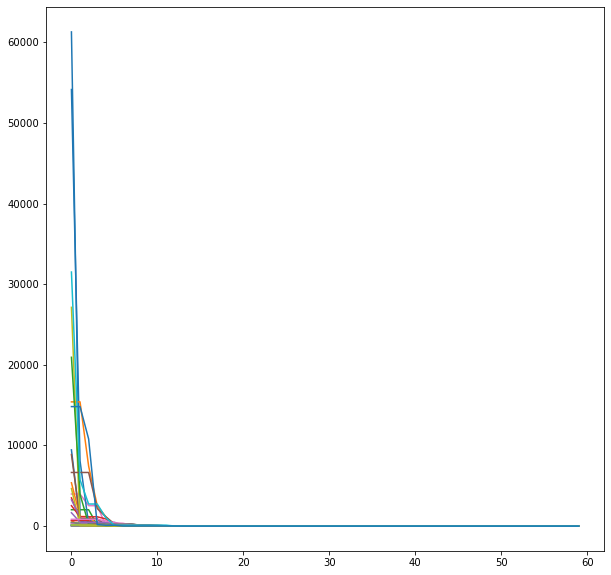

10d HCEF
best in 31 runs: 1.159129101108463
worst in 31 runs: 6.285907277818817
mean: 3.0805698053850086
std: 1.1114110269001967
best solution: [0.11956350724076259, 0.030462490666930575, -0.0659796554581571, -0.0320448011909126, 0.028895863110686065, -0.007163581908967761, 0.0003143477708365573, 7.313016602551433e-05, -8.908274717108703e-05, 0.0006655719521395454]
average runtime: 2.0555104594076834
highest runtime: 2.988800048828125
lowest runtime: 1.751776933670044


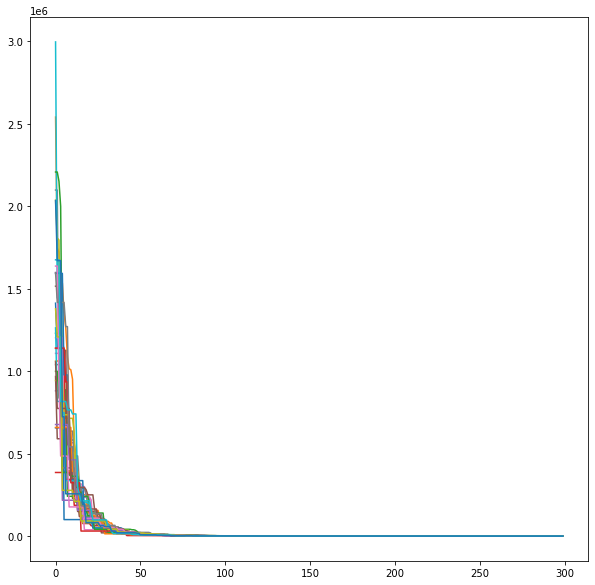

20d HCEF
best in 31 runs: 741.3897490322973
worst in 31 runs: 1698.4872536601492
mean: 1110.627378513339
std: 232.30350053811048
best solution: [3.7887737558827483, 1.1805387767306539, 3.196674581092937, -0.9938004161371824, 2.0392339932084678, -1.3623938832182678, 0.7142454888810991, 0.8318876638647035, 0.5730634154559404, -0.08279508129736178, 0.27221276633522057, -0.03658503468673424, -0.06267183943559379, -0.04305666932379428, 0.007545184042614894, 0.02254396347555636, -0.022284293706340885, -0.005806885303609198, -0.0027156032336890634, 0.0015534308615293615]
average runtime: 5.85769167254048
highest runtime: 8.358510971069336
lowest runtime: 4.737890243530273


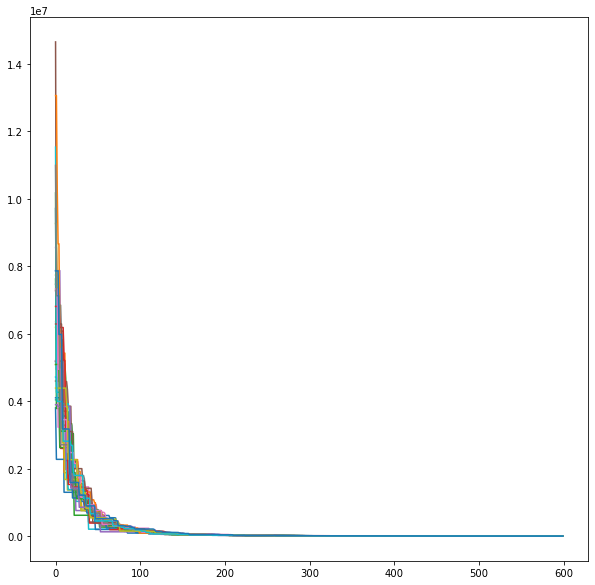

In [7]:
## HCEF
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d HCEF")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"HCEF",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d HCEF")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"HCEF",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d HCEF")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"HCEF",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()


(60, 100, 2)


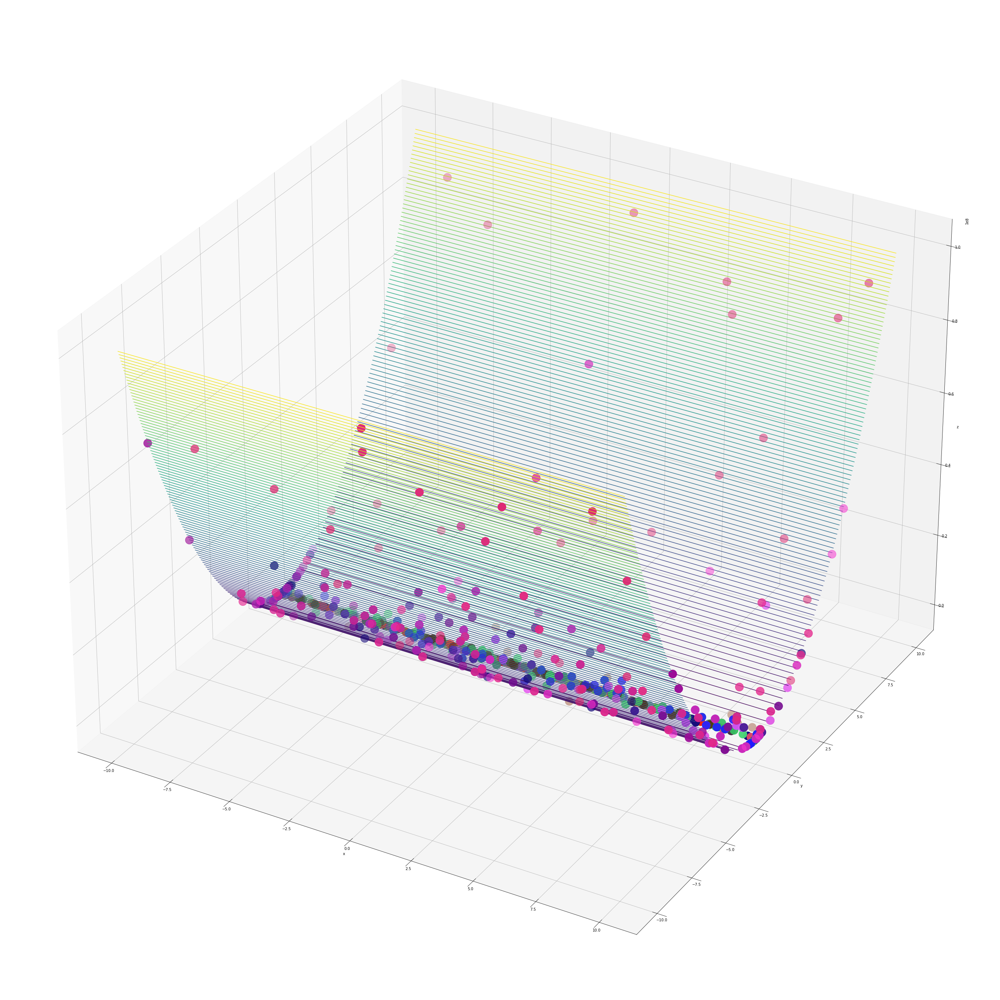

In [8]:
plot_generation_func(p_record_31[0], f_HCEF)

2d f_BC
best in 31 runs: 1.1472277728432159e-08
worst in 31 runs: 2.7616308218242756e-06
mean: 4.2642204591798533e-07
std: 6.324263956376047e-07
best solution: [-6.548045561607192e-05, 8.476194700892492e-08]
average runtime: 0.18938714458096412
highest runtime: 0.3670332431793213
lowest runtime: 0.1770334243774414


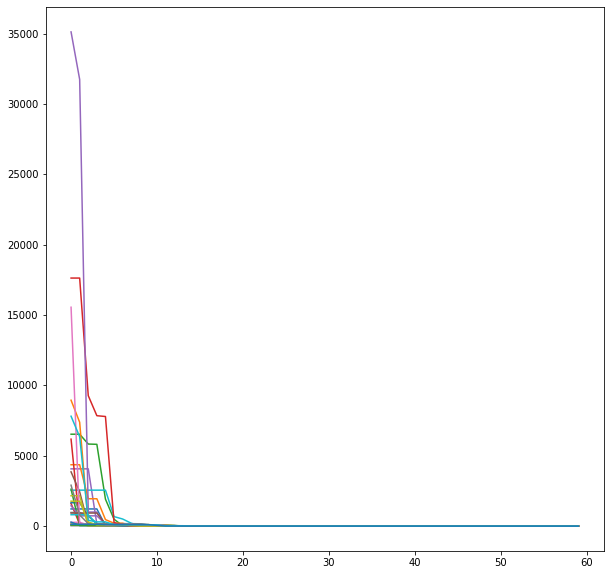

10d f_BC
best in 31 runs: 467.69662775437604
worst in 31 runs: 5086.144854085046
mean: 2167.064391507486
std: 986.4483983983795
best solution: [-6.967859225566164, 0.01187077537517765, -0.002408228139766576, -0.011353150785151036, 0.002547939268841861, 0.005762522523804794, 5.805244675368554e-05, -0.00778180156623731, 0.004270710022956856, 0.005003921649815233]
average runtime: 1.1322081396656651
highest runtime: 1.221003532409668
lowest runtime: 1.1019985675811768


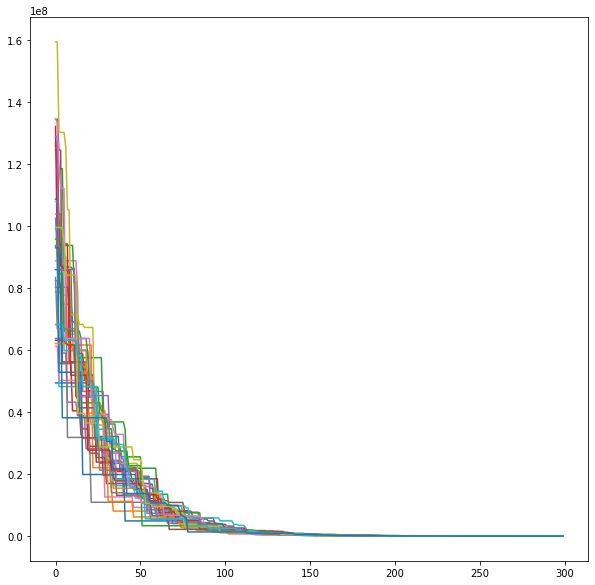

20d f_BC
best in 31 runs: 7100177.421133208
worst in 31 runs: 15566790.600303253
mean: 10976926.030415697
std: 1661945.2681918829
best solution: [1.1241066261645853, -0.5390710160302505, -1.323462065356108, -0.08721571749999213, -0.5735509697246728, 1.0570471311907992, -0.23761872614954743, 0.3544599623286607, -0.6219607042152381, -0.19519803390525203, 1.0624581246399396, 0.1439754492804809, -0.3694075143377208, -0.10189343112336036, 0.2633733931501485, -0.07109070478812951, 0.33701572246722755, -1.0624045467317198, 0.5773002892130722, 0.22516761953047265]
average runtime: 2.8123665932686097
highest runtime: 3.060002088546753
lowest runtime: 2.733654737472534


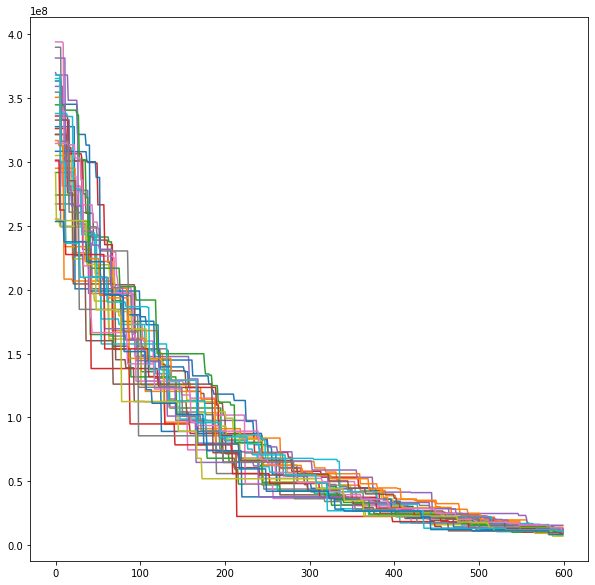

(60, 100, 2)


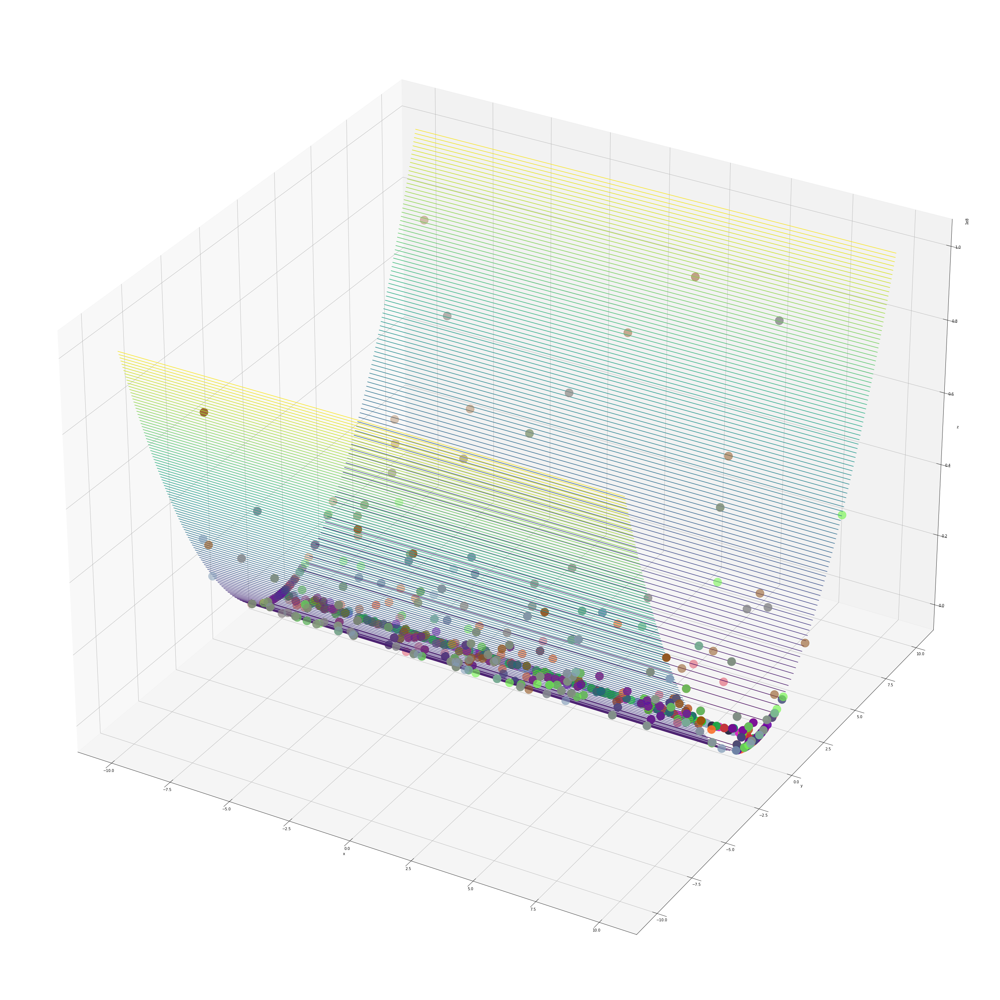

In [14]:
## f_BC
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_BC")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"BC",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_BC")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"BC",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_BC")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"BC",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_BC)

2d f_Discus
best in 31 runs: 1.5531375974802725e-08
worst in 31 runs: 3.025548664085339e-06
mean: 3.957324011802884e-07
std: 5.887316365530513e-07
best solution: [-8.610800308397022e-08, 9.009321716807375e-05]
average runtime: 0.18635482172812184
highest runtime: 0.21699953079223633
lowest runtime: 0.17896533012390137


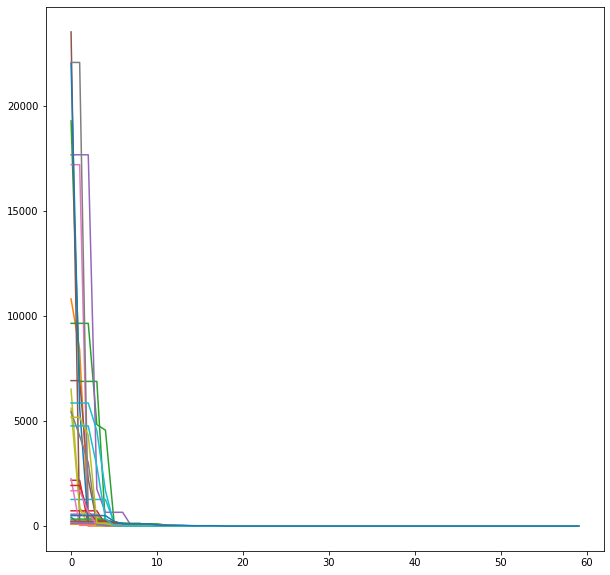

10d f_Discus
best in 31 runs: 0.01705146809855046
worst in 31 runs: 0.1089385419406676
mean: 0.05509143048873905
std: 0.024463070658055815
best solution: [-4.589530226331638e-06, 0.0024354309653023543, -0.01273213470954191, -0.00976176146864978, -0.009604473320248802, 0.04344277195110302, -0.03304939347852817, 0.03496714844499507, -0.07493391351940373, -0.08281001224532732]
average runtime: 1.1304591394239856
highest runtime: 1.2029998302459717
lowest runtime: 1.0963678359985352


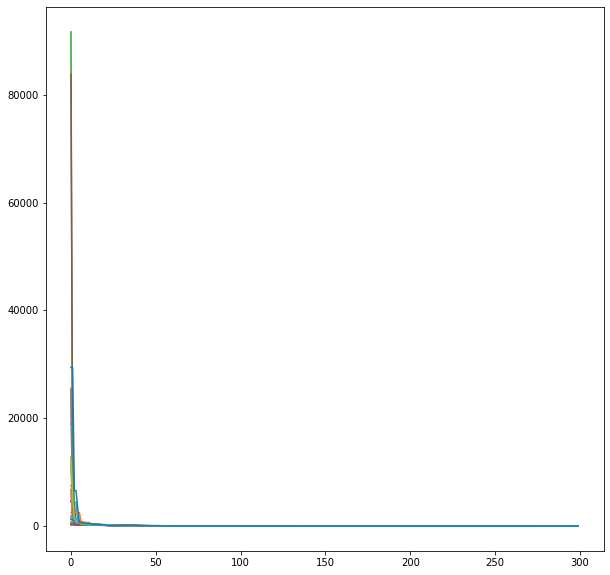

20d f_Discus
best in 31 runs: 14.286410848332112
worst in 31 runs: 31.630044283716156
mean: 21.377469189211972
std: 4.678145140077145
best solution: [4.361889111764933e-06, 0.3693775225829571, -1.1535665507323134, -0.08380171705346517, -0.3710598506438463, -0.35942284889206855, -0.7624986123555841, -0.6650611344484193, 1.116047436245956, 1.5052457917009423, 0.8902777122779302, 1.1947782435141696, -1.0385460207801829, 0.14592990615631135, -0.9505392480919839, 0.24065168949709803, 0.8158891730927885, 0.07358408741842393, -0.5403870072462489, -1.6630686484365766]
average runtime: 2.775587135745633
highest runtime: 2.9761292934417725
lowest runtime: 2.6869969367980957


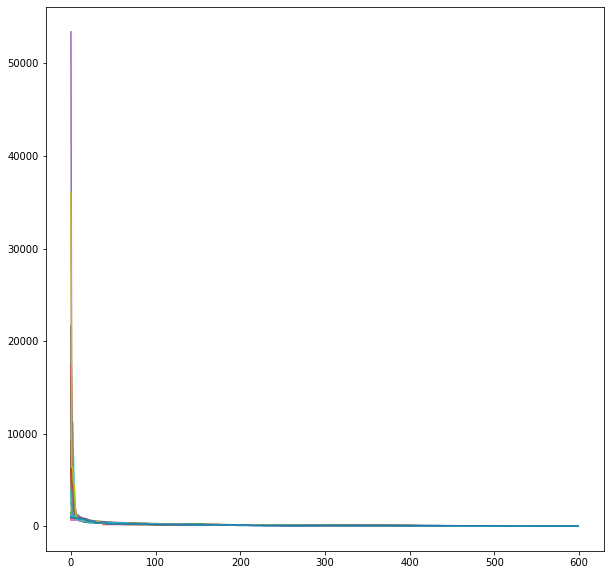

(60, 100, 2)


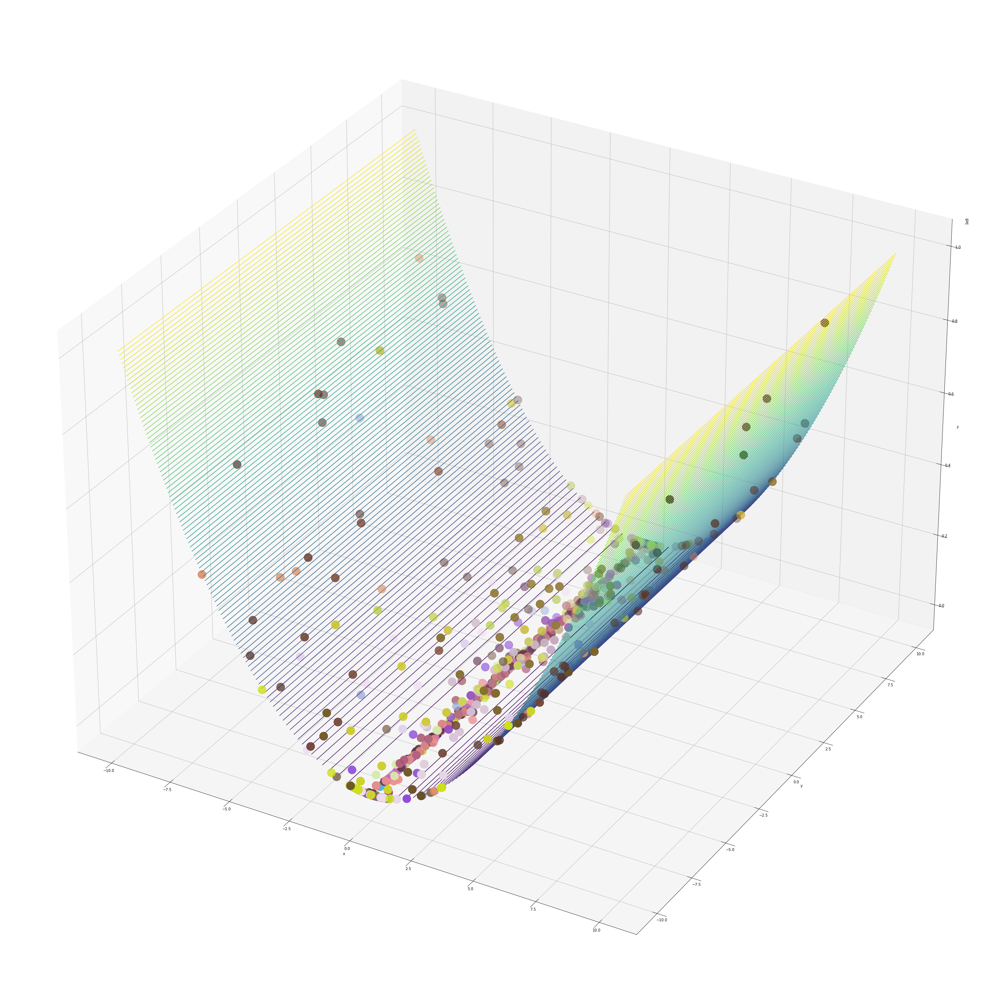

In [15]:
## f_Discus
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Discus")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Discus",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Discus")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Discus",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Discus")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Discus",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Discus)

2d f_Rosenbrock
best in 31 runs: 5.805906427655035e-07
worst in 31 runs: 0.0013572664459152487
mean: 0.0001244181817270877
std: 0.0002584854912918493
best solution: [0.9992436263765556, 0.9984970387483099]
average runtime: 0.18882486897130166
highest runtime: 0.2219984531402588
lowest runtime: 0.18296599388122559


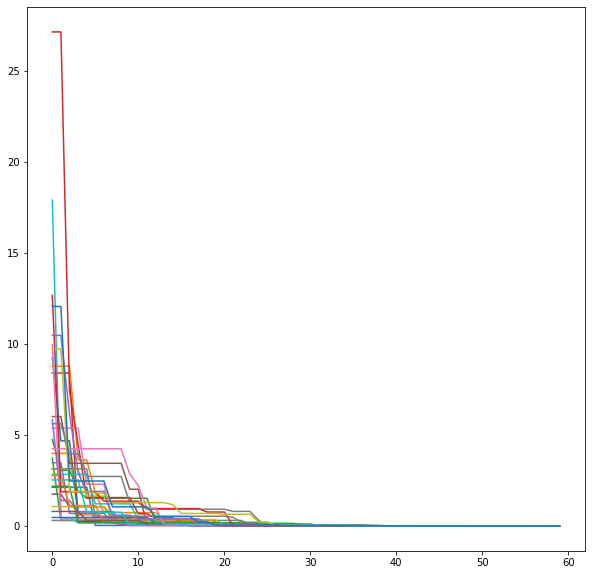

10d f_Rosenbrock
best in 31 runs: 15.16360467220433
worst in 31 runs: 50.243790157327
mean: 29.26696772874057
std: 8.308701728456922
best solution: [0.215538946675167, 0.12296315878953402, 0.12833984042787566, 0.04628270620287578, 0.1489753717633655, 0.13962444788716483, 0.07174326994229174, 0.03379679315722928, 0.0953848829685079, 0.12299883486761978]
average runtime: 1.3151309413294638
highest runtime: 1.4080102443695068
lowest runtime: 1.2720375061035156


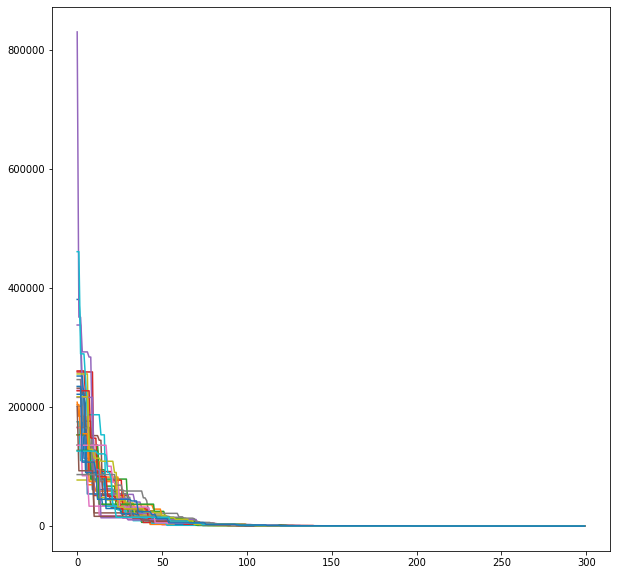

20d f_Rosenbrock
best in 31 runs: 4074.14054135133
worst in 31 runs: 20469.932161152232
mean: 9636.064585720384
std: 4124.12077834915
best solution: [0.03396949926786397, 0.8857474715474564, -0.7525174878914375, 1.9071921361744517, 0.1376164051270088, -0.5682928048721583, -1.3256948064405436, 1.6454702731291486, -0.19348817591431783, 0.5603728314263301, -0.2985890189917851, -0.5072740027748027, -0.49088226456993234, -0.41329162416860044, 0.5111373587480545, 1.2303224900515386, 0.10023365995479905, 0.2871789163222809, 2.4580844966723485, 7.051574224542972]
average runtime: 3.5449548075276036
highest runtime: 3.8246283531188965
lowest runtime: 3.439044237136841


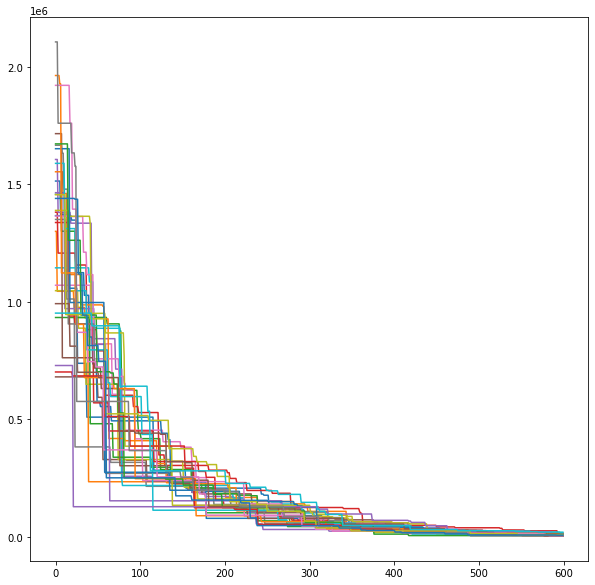

(60, 100, 2)


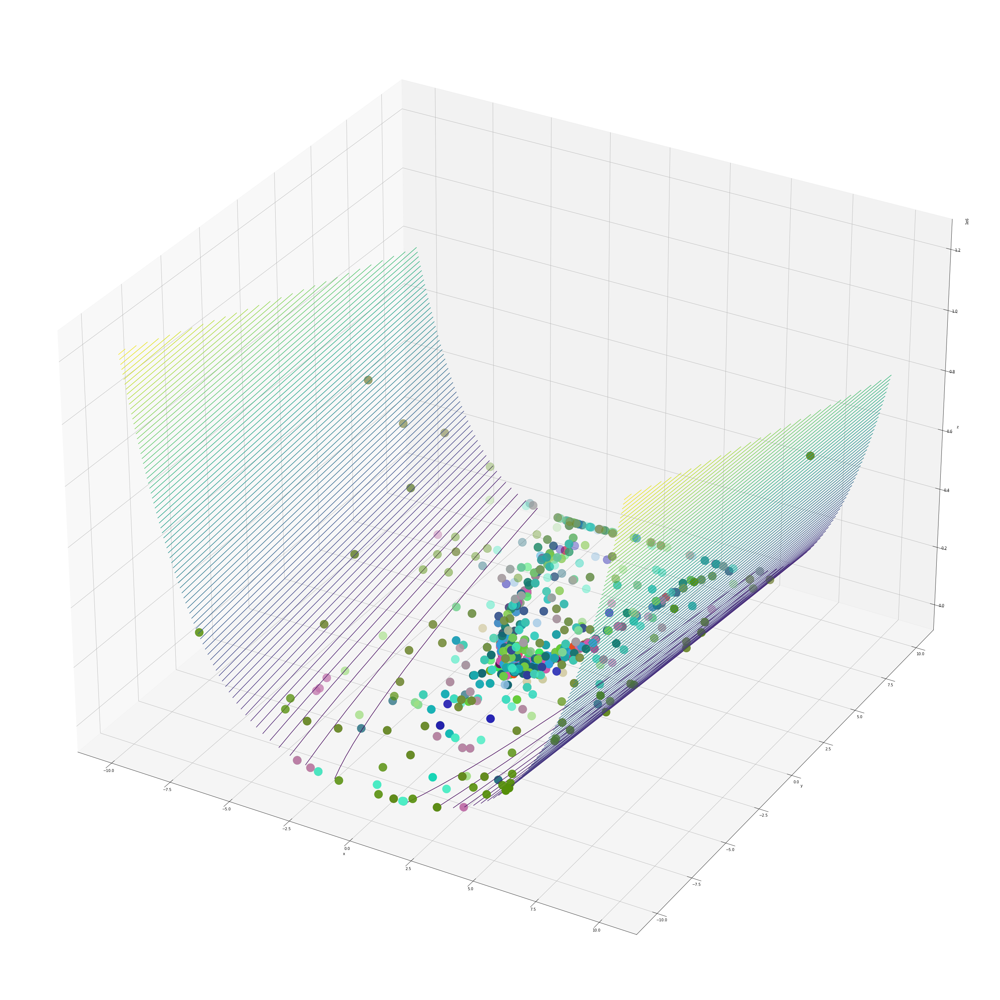

In [16]:
## f_Rosenbrock
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Rosenbrock")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Rosenbrock",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Rosenbrock")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Rosenbrock",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Rosenbrock")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Rosenbrock",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Rosenbrock)

2d f_Ackley
best in 31 runs: 3.6736855801855484e-06
worst in 31 runs: 0.0001319888740174413
mean: 5.129674165935396e-05
std: 3.477823161920761e-05
best solution: [-1.1457068057306463e-06, 6.118091010020834e-07]
average runtime: 0.26641947223294166
highest runtime: 0.2870001792907715
lowest runtime: 0.2539644241333008


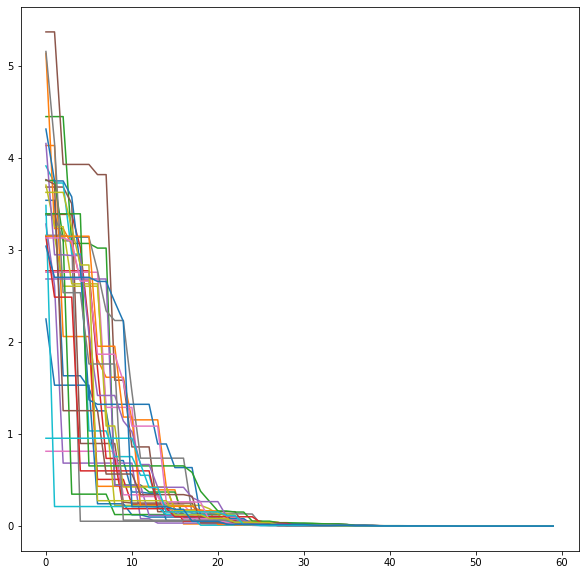

10d f_Ackley
best in 31 runs: 0.15895352967243115
worst in 31 runs: 1.2484844884443977
mean: 0.6768692018191788
std: 0.22162809131074235
best solution: [-0.04391081910739665, 0.03960650859555244, -0.005489242002144901, 0.011110519856077986, -0.004225500083083672, -0.02760030367671988, -0.020621634163446256, -0.011200520112094471, -0.044702805742103835, -0.03645077694999031]
average runtime: 1.8739019593884867
highest runtime: 2.0089986324310303
lowest runtime: 1.8285300731658936


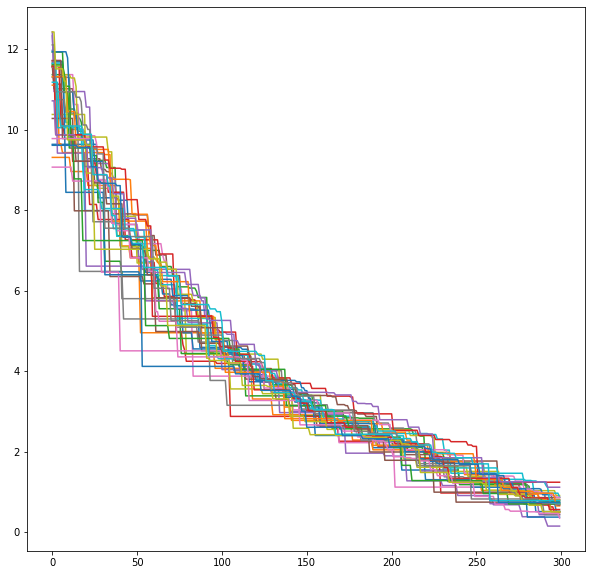

20d f_Ackley
best in 31 runs: 3.835682729506964
worst in 31 runs: 5.9433678346987335
mean: 5.215759448617937
std: 0.4340099366953477
best solution: [0.962036557191609, 0.5408803535991431, -0.1861983563312295, -0.5379400733465781, 1.3027514399921918, 0.12995465238158732, 1.203194914793626, 0.8314129024421357, 0.042362056043172336, -0.0037935159977249278, -0.1796886792013832, 0.987546383509672, -0.09007584294900406, 0.11843553078219093, -0.5089328090741142, 0.9169091894715562, 0.766566468558552, -1.1061451678877618, -0.22659104803930064, -0.06517122821909249]
average runtime: 5.3189693650891705
highest runtime: 5.995033264160156
lowest runtime: 5.048964738845825


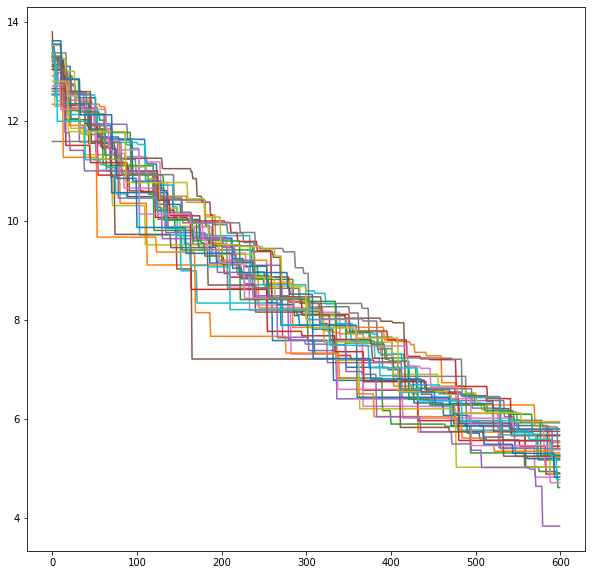

(60, 100, 2)


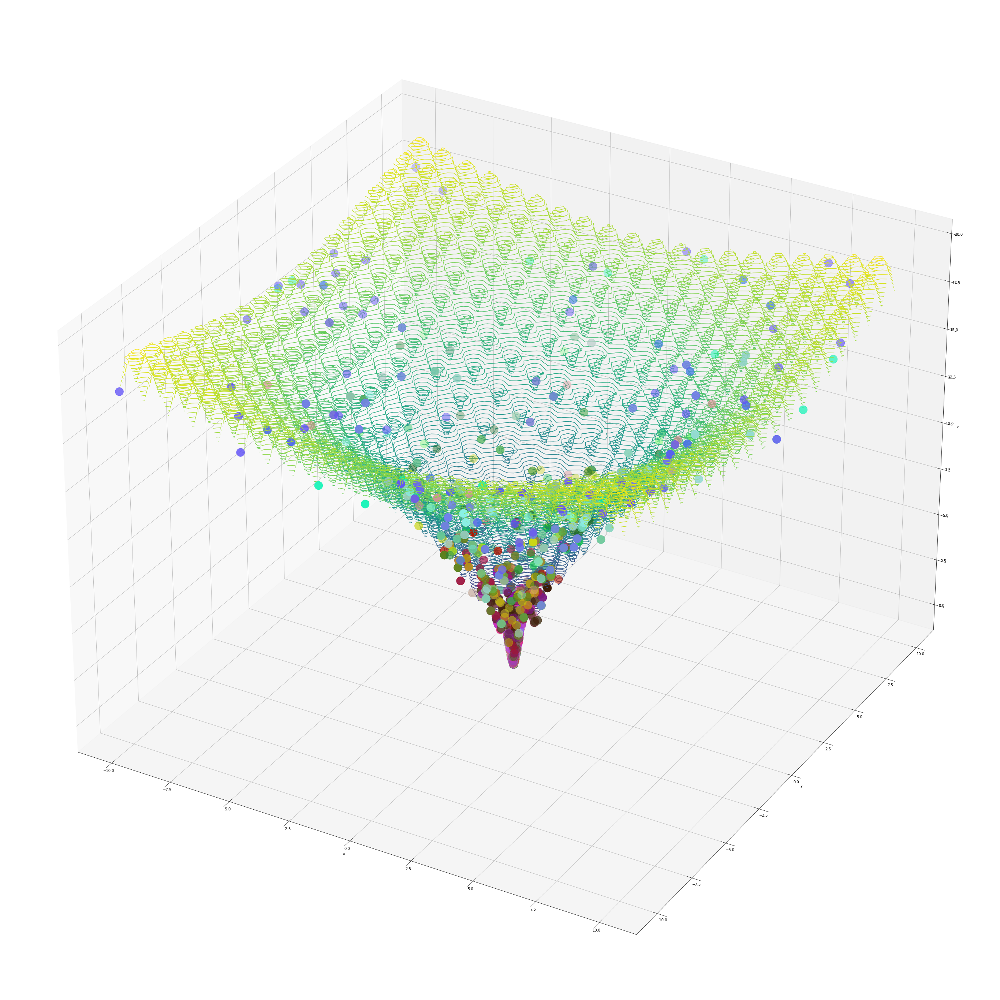

In [17]:
## f_Ackley
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Ackley")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Ackley",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Ackley")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Ackley",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Ackley")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Ackley",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Ackley)

2d f_Weierstrass
best in 31 runs: 0.0
worst in 31 runs: 0.0
mean: 0.0
std: 0.0
best solution: [-10.0, -10]
average runtime: 1.2242711744000834
highest runtime: 1.3779990673065186
lowest runtime: 1.1689984798431396


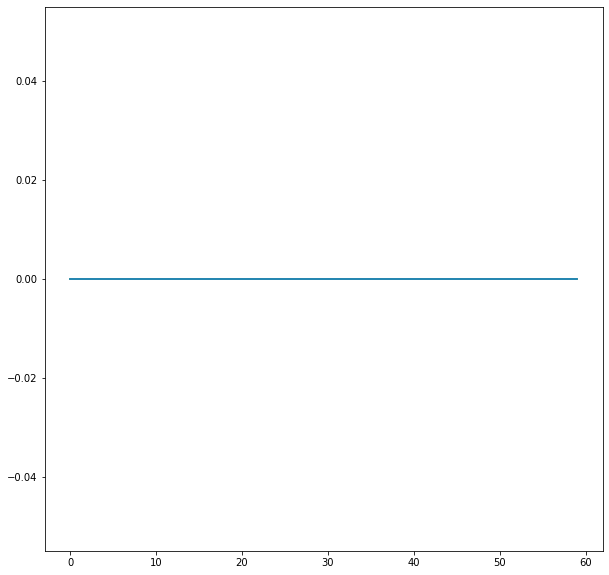

10d f_Weierstrass
best in 31 runs: 0.0
worst in 31 runs: 0.0
mean: 0.0
std: 0.0
best solution: [-10, -10, 10.0, 10.0, -10, 10, -10, 10, -10.0, 6.0]
average runtime: 19.05347910235005
highest runtime: 20.19712543487549
lowest runtime: 18.34751296043396


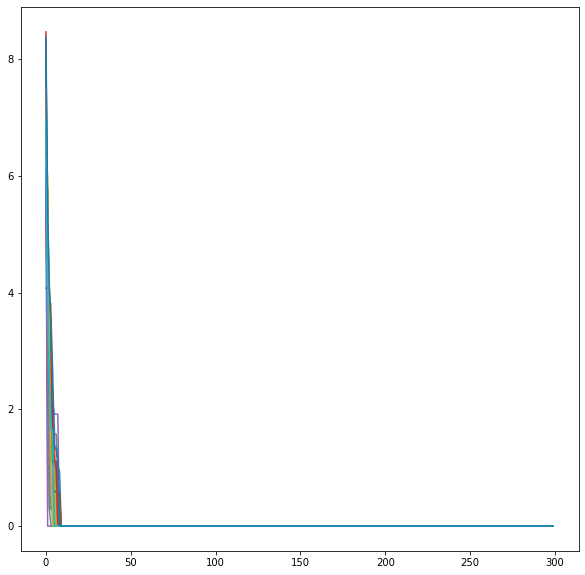

20d f_Weierstrass
best in 31 runs: 0.0
worst in 31 runs: 0.0
mean: 0.0
std: 0.0
best solution: [-6.0, 10.0, -6.0, -10.0, 10.0, 10.0, 10.0, 6.0, 10.0, 10.0, -10, 6.0, 6.0, 10.0, 10.0, -10.0, 10.0, 10.0, -10.0, 10.0]
average runtime: 70.96384336871486
highest runtime: 73.71726560592651
lowest runtime: 69.79228210449219


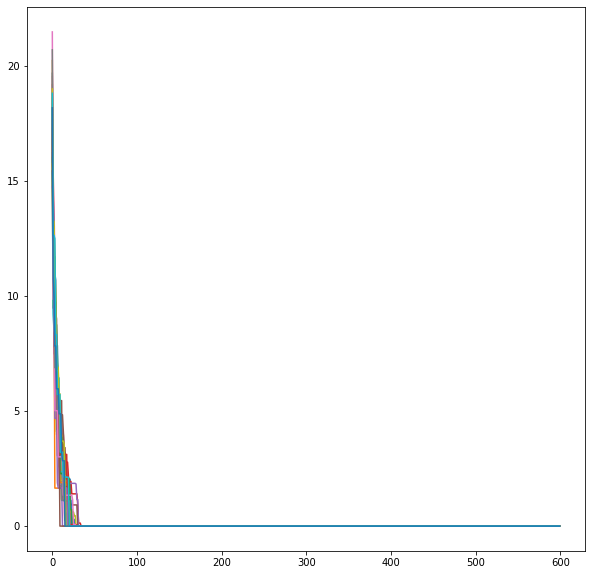

(60, 100, 2)


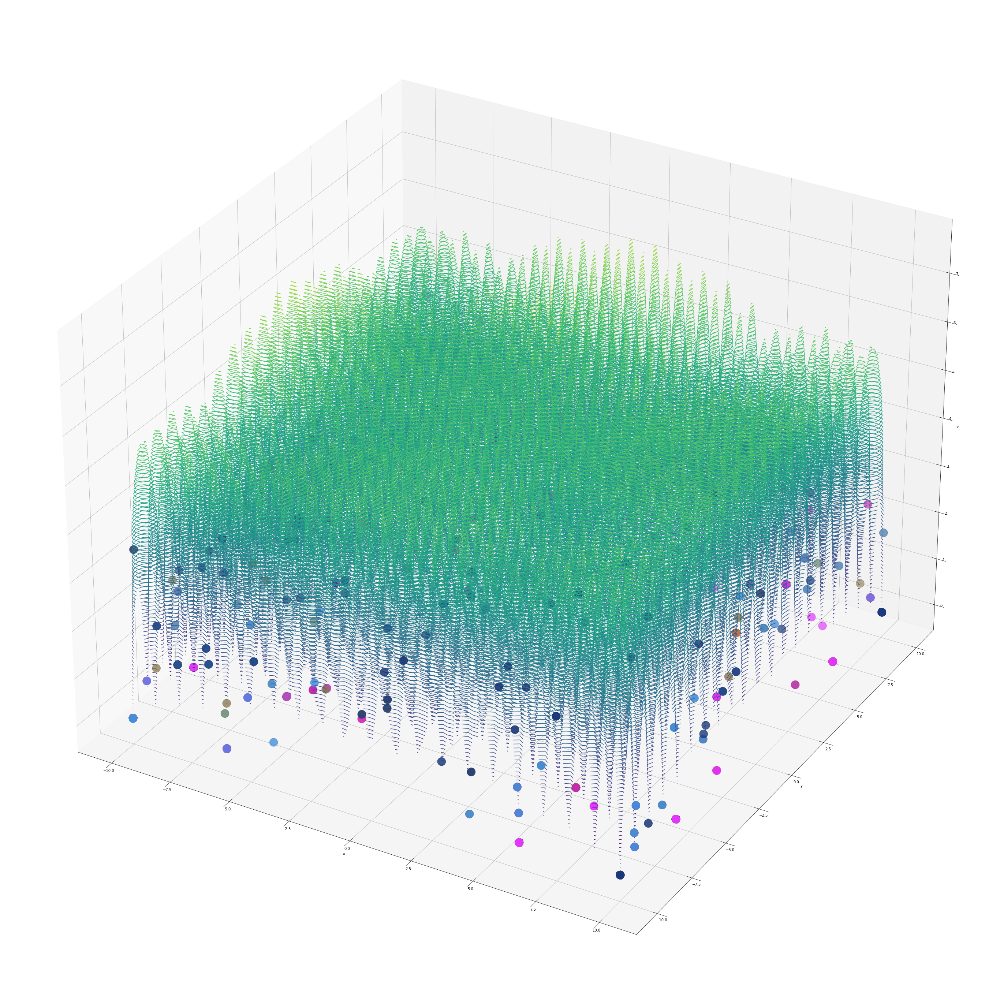

In [18]:
## f_Weierstrass
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Weierstrass")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Weierstrass",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Weierstrass")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Weierstrass",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Weierstrass")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Weierstrass",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Weierstrass)

2d f_Griewank
best in 31 runs: 8.215748464579509e-05
worst in 31 runs: 0.008129736127078013
mean: 0.0026544504339265397
std: 0.0025557978389830083
best solution: [-0.011569516573074617, -0.0077932744626045825]
average runtime: 0.2550059364688012
highest runtime: 0.2840306758880615
lowest runtime: 0.2429966926574707


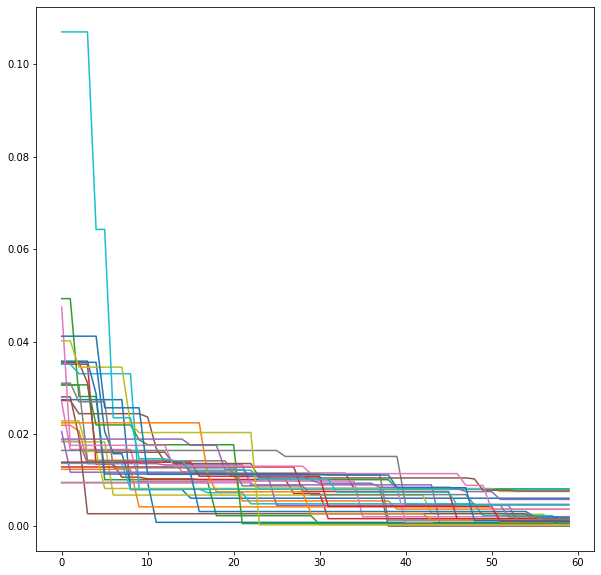

10d f_Griewank
best in 31 runs: 0.19468200851626594
worst in 31 runs: 0.5162593143987441
mean: 0.4030346713164357
std: 0.07072424904282071
best solution: [-9.361144842681597, -0.09385007679144408, -5.2190950696758165, -6.663063302873658, -0.071808580356155, 7.658948767642555, -8.106556002635141, -0.8755910643978648, -10.0, -0.21406426300335157]
average runtime: 2.6413310727765484
highest runtime: 2.9140002727508545
lowest runtime: 2.443000555038452


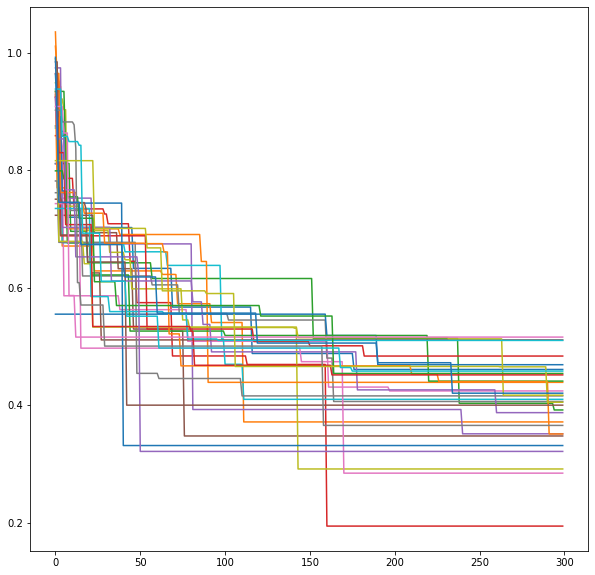

20d f_Griewank
best in 31 runs: 0.6690723149254079
worst in 31 runs: 0.9153819569272821
mean: 0.8177476017267524
std: 0.06990856816909138
best solution: [-0.4946408895535314, -4.1715014852887, 4.8344737095969235, -0.7604900280250337, -0.4002756826698164, -0.1817258168063558, -1.2948505712500875, 0.9258848408003272, 0.37364631575524526, 1.6455205401736273, 0.8502665888510057, 2.3388964101972745, -1.295450326979656, -0.19049249404170143, -0.25456205632420725, -1.109298373124112, 0.07452638120091215, -0.06726400952072487, 0.35052012888852735, 1.2414103288049572]
average runtime: 8.344437937582693
highest runtime: 8.92862606048584
lowest runtime: 7.854728937149048


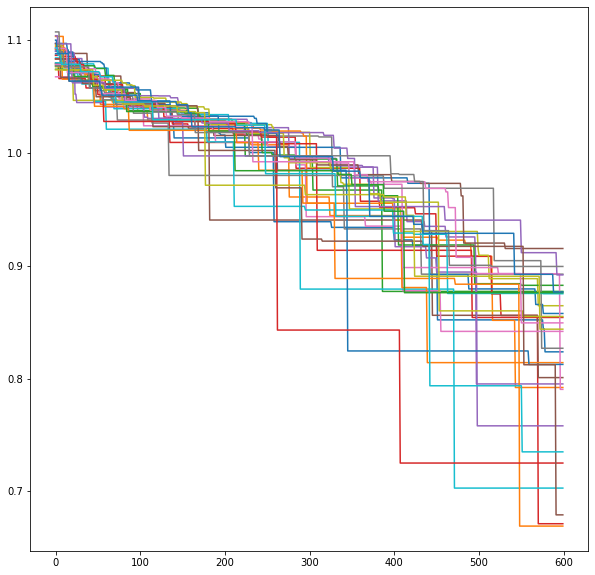

(60, 100, 2)


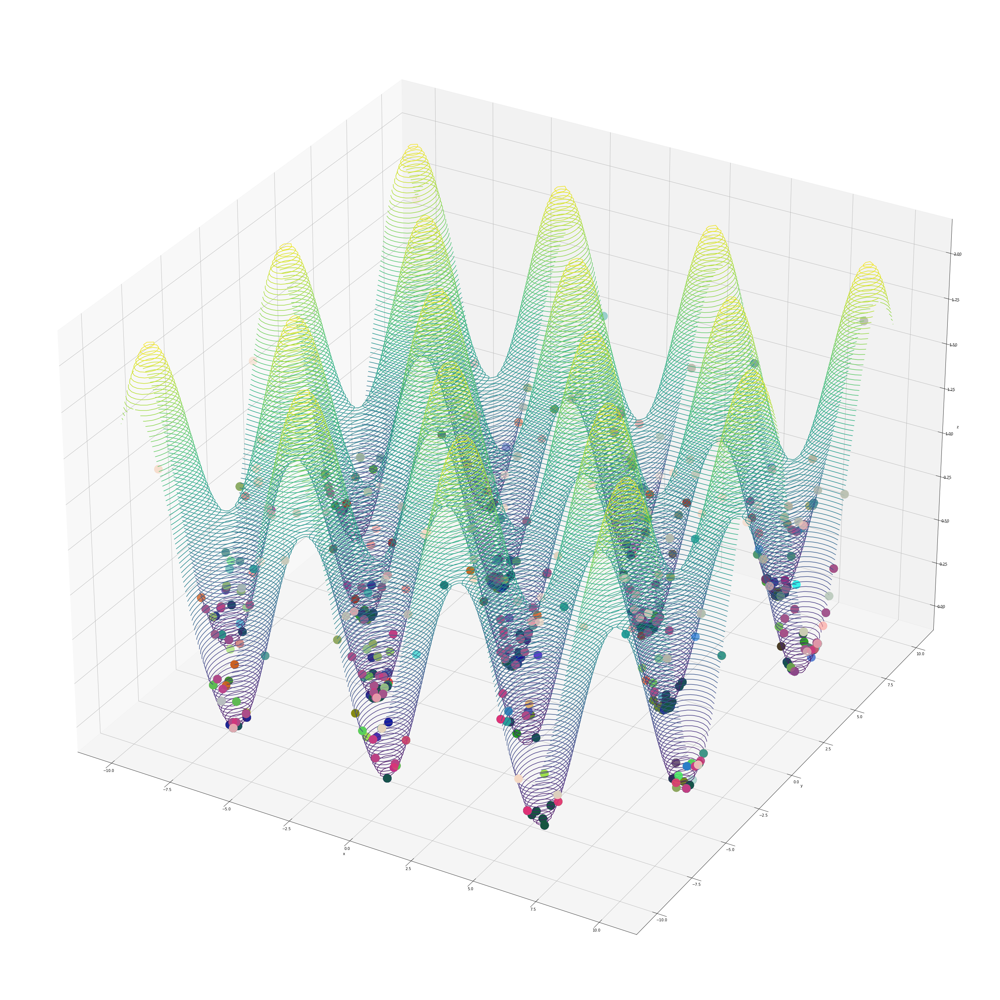

In [19]:
## f_Griewank
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Griewank")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Griewank",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Griewank")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Griewank",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Griewank")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Griewank",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Griewank)

2d f_Rastrigin
best in 31 runs: 6.426578138096772e-05
worst in 31 runs: 0.08642671039331873
mean: 0.010873621874046986
std: 0.016144293772740546
best solution: [0.0005031931862254681, -0.0002659511811063508]
average runtime: 0.23713007280903478
highest runtime: 0.27899980545043945
lowest runtime: 0.2169792652130127


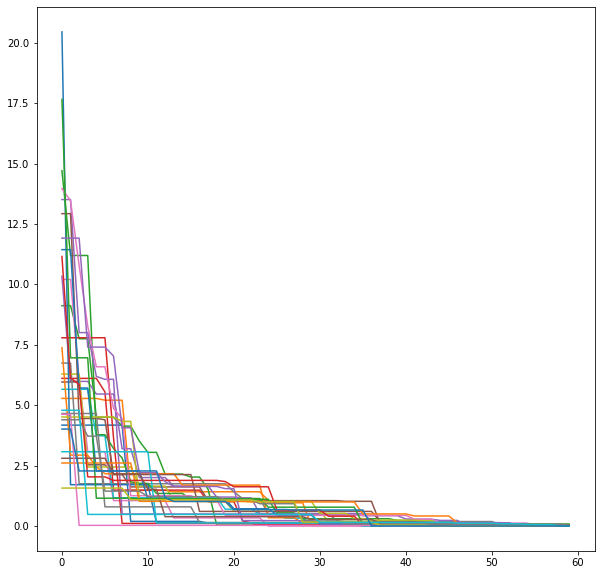

10d f_Rastrigin
best in 31 runs: 34.24966152054999
worst in 31 runs: 57.20410795356325
mean: 46.92866088638545
std: 5.866286014769694
best solution: [0.873350473943383, -0.010046434590726072, 0.032723668624315444, -0.9877770887724209, 2.996698704322295, -0.1825438566033888, -0.9694989434632653, 0.9657556664649787, 0.9227822023516874, -0.7583201087312528]
average runtime: 2.0856959358338387
highest runtime: 2.3370349407196045
lowest runtime: 1.9759678840637207


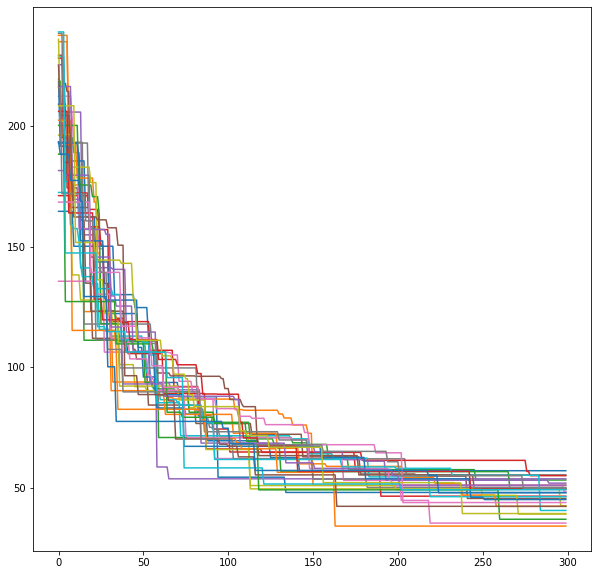

20d f_Rastrigin
best in 31 runs: 169.0092423560592
worst in 31 runs: 237.44187228126077
mean: 188.74006114966522
std: 16.299677872322754
best solution: [-1.1784377006804758, 3.1372072418064185, -1.0384941701008252, -0.8983447369202326, 0.24191139128757877, 0.8923470755586784, 3.8737289285254293, -2.584720591110313, 0.09140581697733463, -1.5278898023961176, 1.787577592729955, -0.10788033609282088, -0.7332042351076016, 1.9912751302427254, 1.8046610253394009, 0.05448616787769778, 0.8717763403468182, 0.34650607533362576, 1.9910910432521334, 1.070090822965434]
average runtime: 6.233740975779872
highest runtime: 6.511006116867065
lowest runtime: 6.176966190338135


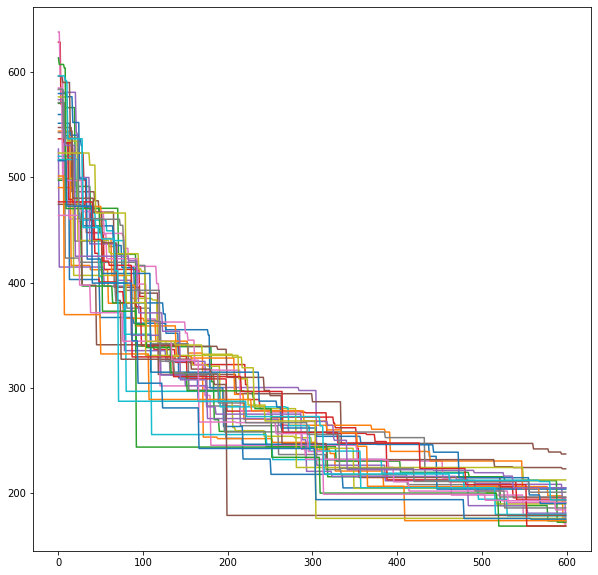

(60, 100, 2)


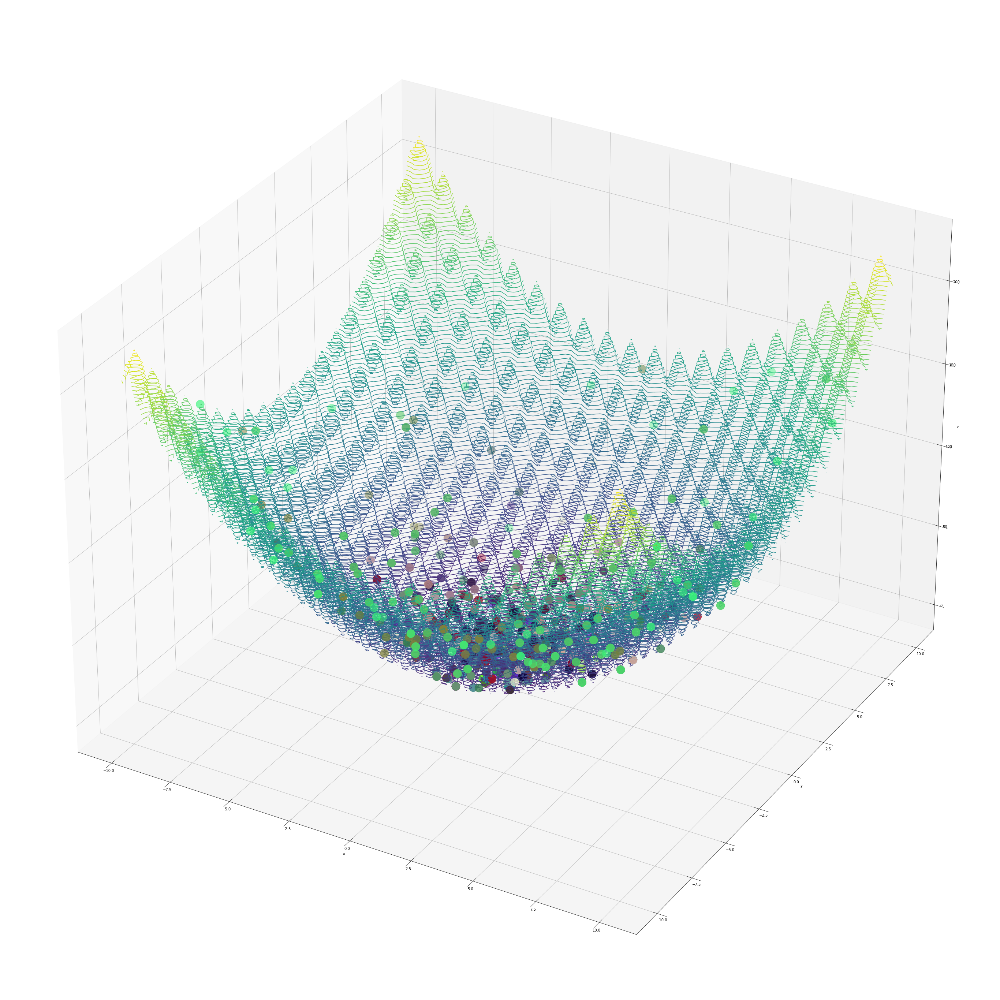

In [20]:
## f_Rastrigin
#2d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("2d f_Rastrigin")
min_2_31,solution_2_31, recordbest_31, p_record_31 , time_elapse_record2= solv_x_times(31,"Rastrigin",2)
val,idx=min((val, idx) for (idx, val) in enumerate(min_2_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_2_31))
print("mean:", np.mean(min_2_31))
print("std:", np.std(min_2_31))
print("best solution:",solution_2_31[idx])
print("average runtime:",np.mean(time_elapse_record2))
print("highest runtime:",max(time_elapse_record2))
print("lowest runtime:",min(time_elapse_record2))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_31)):
    plt.plot(recordbest_31[i])
plt.show()

#10d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("10d f_Rastrigin")
min_10_31,solution_10_31, recordbest_10_31, p_record_10_31 , time_elapse_record10= solv_x_times(31,"Rastrigin",10)
val,idx=min((val, idx) for (idx, val) in enumerate(min_10_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_10_31))
print("mean:", np.mean(min_10_31))
print("std:", np.std(min_10_31))
print("best solution:",solution_10_31[idx])
print("average runtime:",np.mean(time_elapse_record10))
print("highest runtime:",max(time_elapse_record10))
print("lowest runtime:",min(time_elapse_record10))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_10_31)):
    plt.plot(recordbest_10_31[i])
plt.show()

#20d
# min val for each run, solutions for each run, best val for every gen for each run, pop for every gen for each run
print("20d f_Rastrigin")
min_20_31,solution_20_31, recordbest_20_31, p_record_20_31 , time_elapse_record20= solv_x_times(31,"Rastrigin",20)
val,idx=min((val, idx) for (idx, val) in enumerate(min_20_31))

print("best in 31 runs:",val)
print("worst in 31 runs:", max(min_20_31))
print("mean:", np.mean(min_20_31))
print("std:", np.std(min_20_31))
print("best solution:",solution_20_31[idx])
print("average runtime:",np.mean(time_elapse_record20))
print("highest runtime:",max(time_elapse_record20))
print("lowest runtime:",min(time_elapse_record20))
fig = plt.figure(figsize=(10, 10))
for i in range(len(recordbest_20_31)):
    plt.plot(recordbest_20_31[i])
plt.show()

plot_generation_func(p_record_31[0], f_Rastrigin)